<a href="https://colab.research.google.com/github/khoslaritwek/Python_Projects/blob/master/ImageStacking.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
# This note book depicts the concept of Max stacking and quantitzation
# our intention is to combine multiple of sky patch and see the results

In [26]:
import numpy as np
import cv2
from google.colab import files
import matplotlib.pyplot as plt
import os
import sys


In [2]:
# lets load our dataset
files.upload()

Saving nightsky.zip to nightsky.zip


In [1]:
! ls

nightsky.zip  sample_data


In [ ]:
! unzip nightsky.zip

In [4]:
! ls

nightsky  nightsky.zip	sample_data


In [ ]:
! ls nightsky/

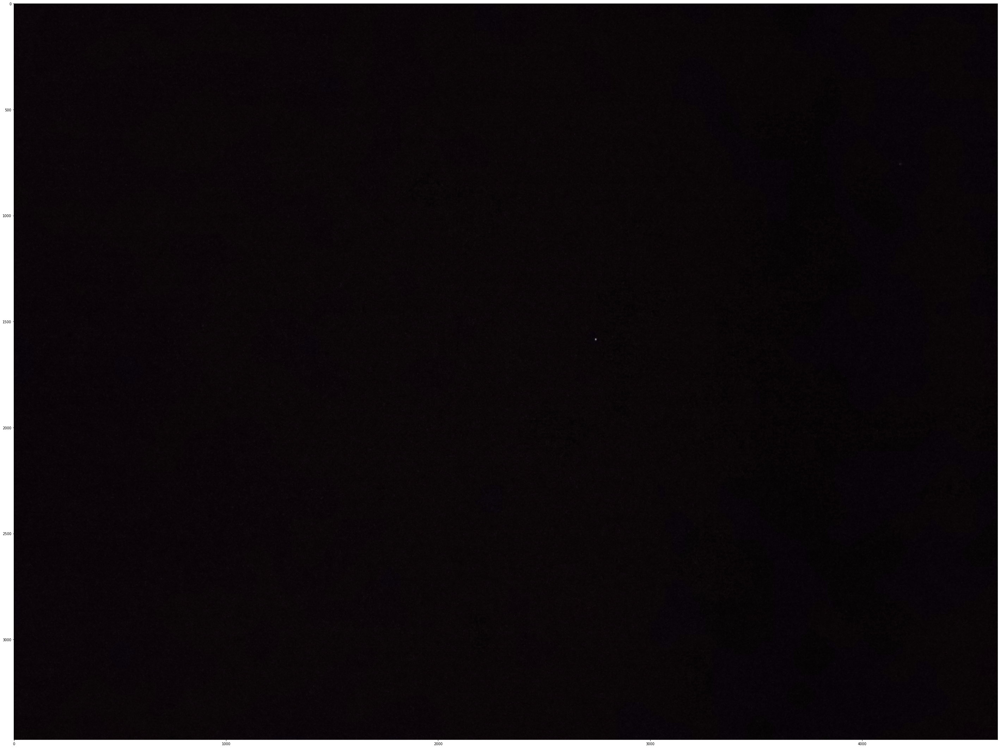

In [24]:
# let look at what we have captured
img = cv2.imread('./nightsky/IMG_20200807_215334533_BURST000_COVER.jpg')
plt.figure(figsize=(50,50))
plt.imshow(img)

In [ ]:
x,y,c = img.shape
#  creating an array of zeros to store the final image
stackedImage = np.zeros((x,y,c))
Imagelist = os.listdir('nightsky')
numImages = len(Imagelist)
numImages

In [29]:
# lets do max stacking
for mem in Imagelist:
  path = 'nightsky/' + mem
  img1 = cv2.imread(path)
  stackedImage = np.maximum(stackedImage, img1) 


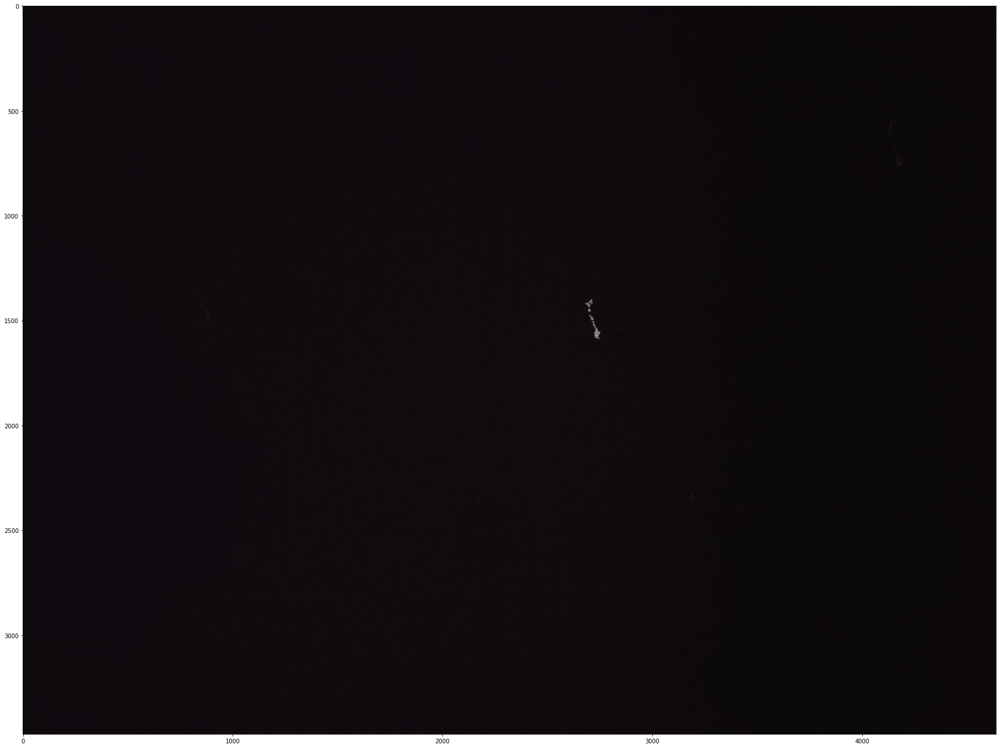

In [31]:
# lets see what we got but 1st we typecast to uint8
stackedImage = np.array(stackedImage, dtype='uint8')
plt.figure(figsize=(30,30))
plt.imshow(stackedImage)

In [35]:
# let perform quantization
# we will set a pixels with value less than equal to 13 to zero which is the mean and all values above this to 100

xi = 0
while xi < x:
  yi = 0
  while yi < y:
    ci = 0
    while ci < c:
      if stackedImage[xi,yi,ci] >= 14:
        stackedImage[xi, yi, ci] = 100
      else:
        stackedImage[xi, yi, ci] = 0;
      
      ci = ci + 1
    yi = yi +1
  xi = xi + 1


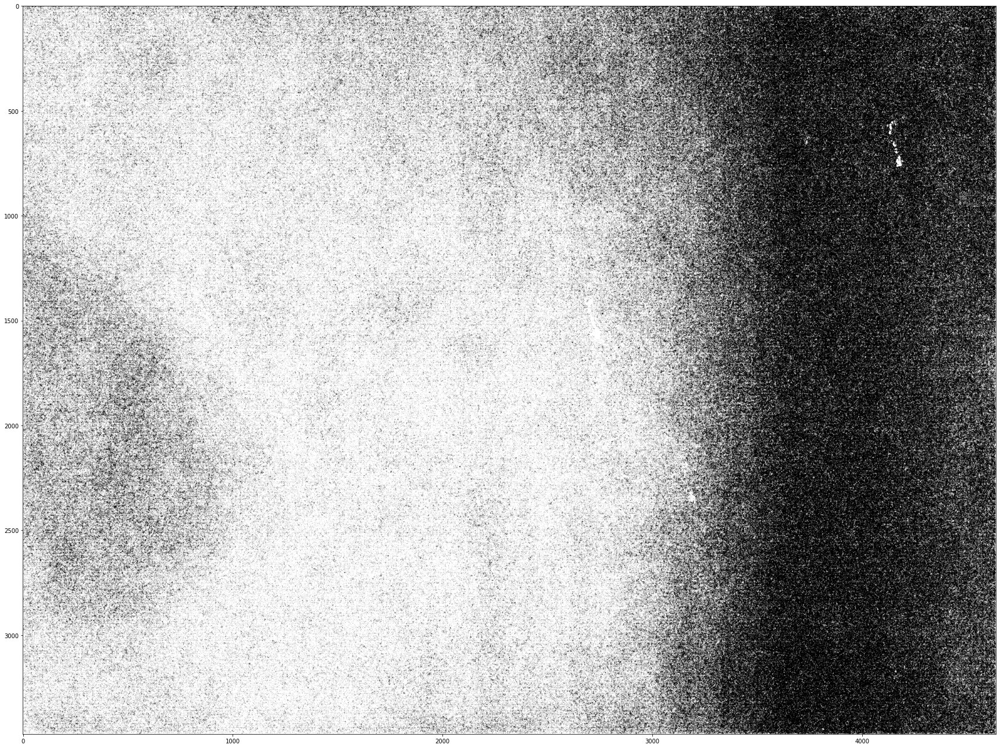

In [40]:
# let type cast agian see the results over all channels
stackedImage = np.array(stackedImage, dtype='uint8')
plt.figure(figsize=(30,30))
plt.imshow(stackedImage[:,:,0],cmap = 'gray')


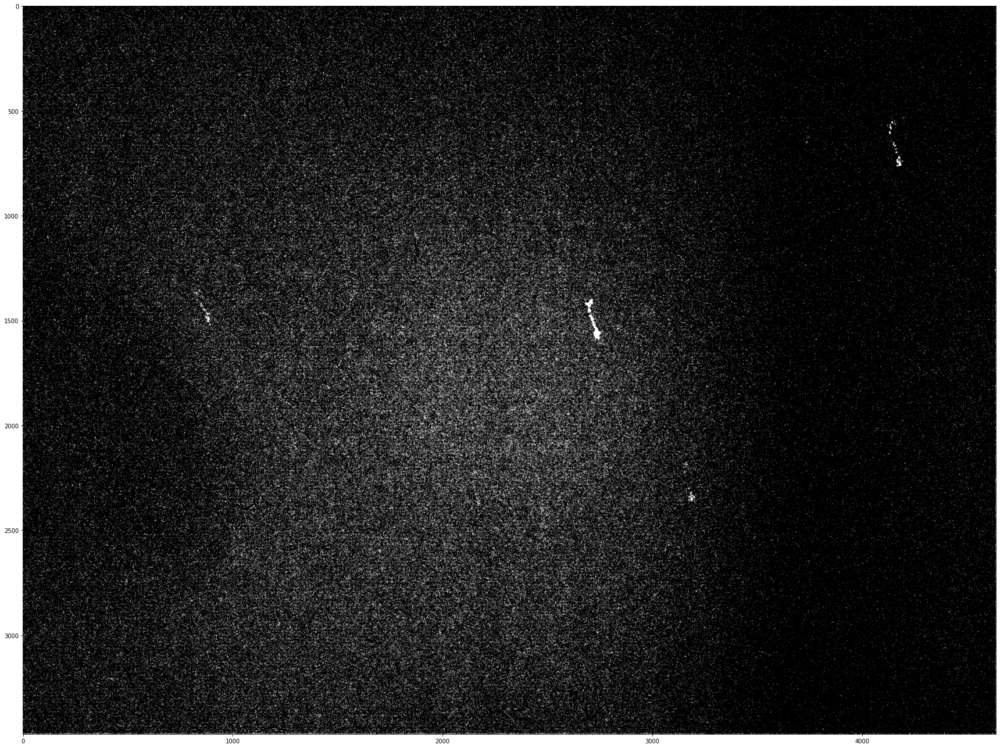

In [41]:
## clearly this one is the best
plt.figure(figsize=(30,30))
plt.imshow(stackedImage[:,:,1],cmap = 'gray')

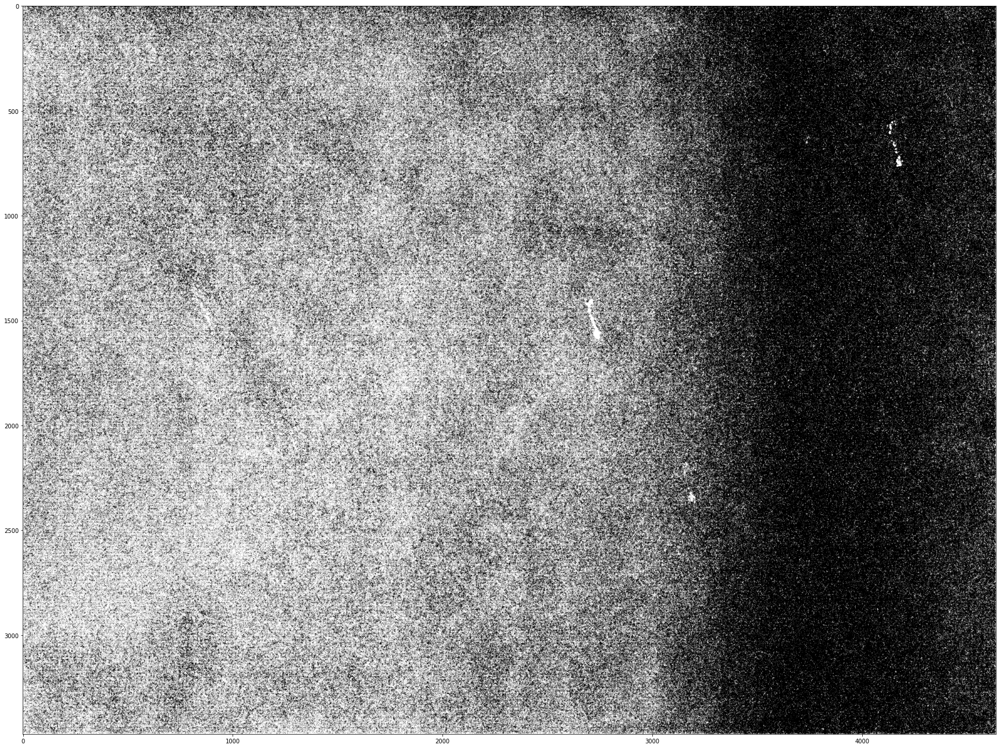

In [42]:
# and on third channel
plt.figure(figsize=(30,30))
plt.imshow(stackedImage[:,:,2],cmap = 'gray')